# Penguin Profiles: A Study of Species, Health, and Habitats in Palmer Archipelago

### Authors: Michelle Nguyen, Kelly Zhu, Mariam Virk

# Milestone 1

## Part 1 - Initial Exploration

In [1]:
# importing libraries 
import pandas as pd
import altair as alt
#alt.data_transformers.enable("default") 
alt.renderers.enable("mimetype")
import warnings
warnings.filterwarnings("ignore")

### Wrangling and tidying dataset 

In [2]:
# reading in raw penguin dataset
penguins = pd.read_csv("data/palmerpenguins_extended.csv")
# Replace underscores with spaces in attribute names
penguins.columns = [col.replace('_', ' ') for col in penguins.columns]
penguins.head()

,species,island,bill length mm,bill depth mm,flipper length mm,body mass g,sex,diet,life stage,health metrics,year
0,Adelie,Biscoe,53.4,17.8,219.0,5687.0,female,fish,adult,overweight,2021
1,Adelie,Biscoe,49.3,18.1,245.0,6811.0,female,fish,adult,overweight,2021
2,Adelie,Biscoe,55.7,16.6,226.0,5388.0,female,fish,adult,overweight,2021
3,Adelie,Biscoe,38.0,15.6,221.0,6262.0,female,fish,adult,overweight,2021
4,Adelie,Biscoe,60.7,17.9,177.0,4811.0,female,fish,juvenile,overweight,2021


In [3]:
# function
# prints out information about the provided dataset, df
def printDatasetInformation(df):
    print("Dataset data shape:", df.shape, '\n') #prints dataframe shape
    
    print("Dataset data information:") #prints dataframe column information, non-null counts, and value type
    print(df.info(), '\n')

    print("Dataset categorical data description:",) # print the unique values of the dataframe's categorical attributes with less than 10 unique values
    df_ = df.select_dtypes(exclude=['int', 'float'])
    for col in df_.columns:
        if df_[col].nunique() < 10:
            print(df_[col].value_counts()) # to print count of every category
            print('\n')
            
    print("Dataset numerical data description:", '\n', df.describe(), '\n') # prints metrics of dataframe's numerical attributes 

In [4]:
print("Penguins Dataset")
printDatasetInformation(penguins)

Penguins Dataset
Dataset data shape: (3430, 11) 

Dataset data information:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3430 entries, 0 to 3429
Data columns (total 11 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   species            3430 non-null   object 
 1   island             3430 non-null   object 
 2   bill length mm     3430 non-null   float64
 3   bill depth mm      3430 non-null   float64
 4   flipper length mm  3430 non-null   float64
 5   body mass g        3430 non-null   float64
 6   sex                3430 non-null   object 
 7   diet               3430 non-null   object 
 8   life stage         3430 non-null   object 
 9   health metrics     3430 non-null   object 
 10  year               3430 non-null   int64  
dtypes: float64(4), int64(1), object(6)
memory usage: 294.9+ KB
None 

Dataset categorical data description:
species
Adelie       1560
Gentoo       1247
Chinstrap     623
Name: count, dtype: in

This dataset states there is an island 'Torgensen', however, the island is actually named 'Torgersen'. Moreover, the year attribute will be treated as temporal. The changes are made and confirmed respectively by the following:

In [5]:
penguins['island'] = penguins['island'].str.replace('Torgensen', 'Torgersen') #rename attribute value
print(penguins['island'].unique())
penguins['year'] = pd.to_datetime(penguins['year'], format='%Y')
print(penguins['year'].dtype)

['Biscoe' 'Dream' 'Torgersen']
datetime64[ns]


We plan to use this extended penguin dataset, however, we want to merge it with another related penguin dataset to acquire more quantitative information and attributes.

In [6]:
# reading in related penguins dataset
penguins_delta = pd.read_csv("data/penguins_lter.csv")
penguins_delta.head()

,studyName,Sample Number,Species,Region,Island,Stage,Individual ID,Clutch Completion,Date Egg,Culmen Length (mm),Culmen Depth (mm),Flipper Length (mm),Body Mass (g),Sex,Delta 15 N (o/oo),Delta 13 C (o/oo),Comments
0,PAL0708,1,Adelie Penguin (Pygoscelis adeliae),Anvers,Torgersen,"Adult, 1 Egg Stage",N1A1,Yes,11/11/07,39.1,18.7,181.0,3750.0,MALE,NaN,NaN,Not enough blood for isotopes.
1,PAL0708,2,Adelie Penguin (Pygoscelis adeliae),Anvers,Torgersen,"Adult, 1 Egg Stage",N1A2,Yes,11/11/07,39.5,17.4,186.0,3800.0,FEMALE,8.94956,-24.69454,NaN
2,PAL0708,3,Adelie Penguin (Pygoscelis adeliae),Anvers,Torgersen,"Adult, 1 Egg Stage",N2A1,Yes,11/16/07,40.3,18.0,195.0,3250.0,FEMALE,8.36821,-25.33302,NaN
3,PAL0708,4,Adelie Penguin (Pygoscelis adeliae),Anvers,Torgersen,"Adult, 1 Egg Stage",N2A2,Yes,11/16/07,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Adult not sampled.
4,PAL0708,5,Adelie Penguin (Pygoscelis adeliae),Anvers,Torgersen,"Adult, 1 Egg Stage",N3A1,Yes,11/16/07,36.7,19.3,193.0,3450.0,FEMALE,8.76651,-25.32426,NaN


In [7]:
print("Related Penguins Dataset, Penguins Delta")
printDatasetInformation(penguins_delta)

Related Penguins Dataset, Penguins Delta
Dataset data shape: (344, 17) 

Dataset data information:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 344 entries, 0 to 343
Data columns (total 17 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   studyName            344 non-null    object 
 1   Sample Number        344 non-null    int64  
 2   Species              344 non-null    object 
 3   Region               344 non-null    object 
 4   Island               344 non-null    object 
 5   Stage                344 non-null    object 
 6   Individual ID        344 non-null    object 
 7   Clutch Completion    344 non-null    object 
 8   Date Egg             344 non-null    object 
 9   Culmen Length (mm)   342 non-null    float64
 10  Culmen Depth (mm)    342 non-null    float64
 11  Flipper Length (mm)  342 non-null    float64
 12  Body Mass (g)        342 non-null    float64
 13  Sex                  334 non-null    obje

We want the full and final dataset to use the quantitative attributes, Delta 15 N (o/oo) and Delta 13 C (o/oo), of the penguin delta dataset, so we will do an inner join on the datasets based on the groupped key of 'Species', 'Island', and 'Sex', as we notice the datasets have similar values for those attributes. 

In [8]:
#filtering penguins_delta dataset for desired attributes to group on and join with penguins dataset
penguins_delta_subset = penguins_delta[['Species', 'Island', 'Sex', 'Delta 15 N (o/oo)', 'Delta 13 C (o/oo)']]

#rename penguins_delta dataset attributes to match the columns names of penguins
penguins_delta_subset.columns = map(str.lower, penguins_delta_subset.columns)

In [9]:
# tidy up feature values in penguins_delta dataset to match feature values in penguins dataset
penguins_delta_filtered = (
    penguins_delta_subset
    .assign(species=lambda x: x['species'].apply(lambda s: s.split()[0])) #splitting for the key word in species
    .assign(sex=lambda x: x['sex'].str.lower())
    .loc[lambda x: x['sex'].isin(['female', 'male'])] #filtering out sex attribute value '.'
    .dropna(subset=['delta 15 n (o/oo)', 'delta 13 c (o/oo)']) #only want non-null values of the quantitative attributes
)
penguins_delta_filtered.head()

,species,island,sex,delta 15 n (o/oo),delta 13 c (o/oo)
1,Adelie,Torgersen,female,8.94956,-24.69454
2,Adelie,Torgersen,female,8.36821,-25.33302
4,Adelie,Torgersen,female,8.76651,-25.32426
5,Adelie,Torgersen,male,8.66496,-25.29805
6,Adelie,Torgersen,female,9.18718,-25.21799


In [10]:
print("Tidied Related Penguins Dataset, Penguins Delta Filtered")
printDatasetInformation(penguins_delta_filtered)

Tidied Related Penguins Dataset, Penguins Delta Filtered
Dataset data shape: (324, 5) 

Dataset data information:
<class 'pandas.core.frame.DataFrame'>
Index: 324 entries, 1 to 343
Data columns (total 5 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   species            324 non-null    object 
 1   island             324 non-null    object 
 2   sex                324 non-null    object 
 3   delta 15 n (o/oo)  324 non-null    float64
 4   delta 13 c (o/oo)  324 non-null    float64
dtypes: float64(2), object(3)
memory usage: 15.2+ KB
None 

Dataset categorical data description:
species
Adelie       139
Gentoo       118
Chinstrap     67
Name: count, dtype: int64


island
Biscoe       162
Dream        119
Torgersen     43
Name: count, dtype: int64


sex
female    163
male      161
Name: count, dtype: int64


Dataset numerical data description: 
        delta 15 n (o/oo)  delta 13 c (o/oo)
count         324.000000         324.0

Now that the related penguin dataset has been wrangled, we will merge the dataset together by doing an inner join.

In [11]:
# Randomly select an example based on the grouping specified
def random_select(group):
    return group.sample(1, random_state = 42)

# Merge the two penguin datasets based on the 'species', 'island', 'sex' grouping
penguins_final = pd.merge(
    penguins,
    penguins_delta_filtered.groupby(['species', 'island', 'sex']).apply(random_select).reset_index(drop=True),
    on=['species', 'island', 'sex'],
    how='inner')
penguins_final.sample(5)

,species,island,bill length mm,bill depth mm,flipper length mm,body mass g,sex,diet,life stage,health metrics,year,delta 15 n (o/oo),delta 13 c (o/oo)
3015,Gentoo,Biscoe,59.1,21.5,250.0,5493.0,male,fish,juvenile,healthy,2023-01-01,8.14756,-25.39369
3167,Gentoo,Biscoe,29.3,20.1,189.0,5363.0,male,krill,juvenile,healthy,2024-01-01,8.14756,-25.39369
191,Adelie,Biscoe,37.3,11.7,174.0,3153.0,female,parental,chick,healthy,2024-01-01,8.73762,-25.09383
447,Adelie,Biscoe,25.0,18.3,225.0,4235.0,male,krill,juvenile,underweight,2024-01-01,8.66271,-25.06390
1413,Adelie,Torgersen,32.3,16.4,177.0,3402.0,male,parental,chick,healthy,2023-01-01,8.66496,-25.29805


In [12]:
print("Final Penguins Dataset, Joined Penguins and Penguins Delta")
printDatasetInformation(penguins_final)

Final Penguins Dataset, Joined Penguins and Penguins Delta
Dataset data shape: (3430, 13) 

Dataset data information:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3430 entries, 0 to 3429
Data columns (total 13 columns):
 #   Column             Non-Null Count  Dtype         
---  ------             --------------  -----         
 0   species            3430 non-null   object        
 1   island             3430 non-null   object        
 2   bill length mm     3430 non-null   float64       
 3   bill depth mm      3430 non-null   float64       
 4   flipper length mm  3430 non-null   float64       
 5   body mass g        3430 non-null   float64       
 6   sex                3430 non-null   object        
 7   diet               3430 non-null   object        
 8   life stage         3430 non-null   object        
 9   health metrics     3430 non-null   object        
 10  year               3430 non-null   datetime64[ns]
 11  delta 15 n (o/oo)  3430 non-null   float64       
 12  

### Data Exploration

| Attribute         | Attribute Type          | Attribute Semantic                  | Cardinality/Range                | Notes |
|-------------------|---------------|---------------------------|----------------------------------------------| ------|
| species           | categorical   | type of penguin           | Gentoo, Adelie, Chinstrap         |
| island            | categorical   | geographic location on a penguin      | Biscoe, Dream, Torgersen                     |
| sex               | categorical   | gender of a penguin     | female, male                      |
| diet              | categorical   | a penguin's diet composition          | krill, fish, parental, squid      |
| life_stage        | ordinal       | life stage of the penguin |  chick, juvenile, adult | chick -> juvenile -> adult
| health_metrics    | ordinal       | health status             | underweight, healthy, overweight  | underweight -> healthy -> overweight |
| bill length mm    | quantitative  | length of a penguin's bill in millimetre     | range: 13.6 to 88.2               |
| bill depth mm     | quantitative  | depth of a penguin's bill in millimetre      | range: 9.1 to 27.9                |
| flipper length mm | quantitative  | length of a penguin's flipper in millimetre   | range: 140 to 308                 |
| body mass g       | quantitative  | weight of a penguin in grams      | range: 2477 to 10549              |
| year              | temporal      | observation year          | range: 2021 to 2025               |
| delta 15 n (o/oo) | quantitative  | isotopic ratio of nitrogen in a penguin's blood sample          | range: 7.99 to 9.51               |
| delta 13 c (o/oo) | quantitative  | isotopic ratio of carbon in a penguin's blood sample         | range: -26.22 to -24.55          |


### Exploratory Data Analysis

In [13]:
print("Final penguins dataset size:", penguins_final.shape)

Final penguins dataset size: (3430, 13)


#### Univariate Summaries and Visualizations

In [14]:
print("Numeric Summaries:")
penguins_final.describe()

Numeric Summaries:


,bill length mm,bill depth mm,flipper length mm,body mass g,year,delta 15 n (o/oo),delta 13 c (o/oo)
count,3430.000000,3430.000000,3430.000000,3430.000000,3430,3430.000000,3430.000000
mean,38.529825,18.447143,207.028863,4834.710496,2023-05-08 09:51:32.011661824,8.641860,-25.201553
min,13.600000,9.100000,140.000000,2477.000000,2021-01-01 00:00:00,7.993000,-26.222270
25%,28.900000,16.600000,185.000000,3843.500000,2022-01-01 00:00:00,8.147560,-25.393690
50%,34.500000,18.400000,203.000000,4633.500000,2024-01-01 00:00:00,8.662710,-25.298050
75%,46.600000,20.300000,226.000000,5622.000000,2024-01-01 00:00:00,9.084580,-24.706150
max,88.200000,27.900000,308.000000,10549.000000,2025-01-01 00:00:00,9.517840,-24.549030
std,13.175171,2.774428,28.944765,1311.091310,NaN,0.510716,0.432745


In [15]:
# make histograms for each quantitative attribute that show the mean value
numeric_univariate_charts = []
for column in penguins_final.select_dtypes(include=['int', 'float']):
    
    chart = alt.Chart(penguins_final).mark_bar().encode(       #encode the histogram
        alt.X(column, bin=alt.Bin(maxbins=20), title=column),
        alt.Y('count()', title='Frequency')
    ).properties(
        width=200, height=150, title='Distribution of ' + column
    )

    mean_value = penguins_final[column].mean() #gather the mean value

    mean_rule = alt.Chart(pd.DataFrame({'mean_value': [mean_value]})).mark_rule(color='red').encode( #encode the line that represents the mean
        alt.X('mean_value:Q'),
        size=alt.value(2)
    )

    mean_text = mean_rule.mark_text( #encode the text for the mean value
        align="left", baseline="middle", dx=3, y=5, color='red'
    ).encode(text='mean_value:Q', size=alt.value(10))

    combined_chart = alt.layer(chart, mean_rule, mean_text)
    numeric_univariate_charts.append(combined_chart)

Numeric univariate visual summaries, with a red line indicating the attribute's mean value


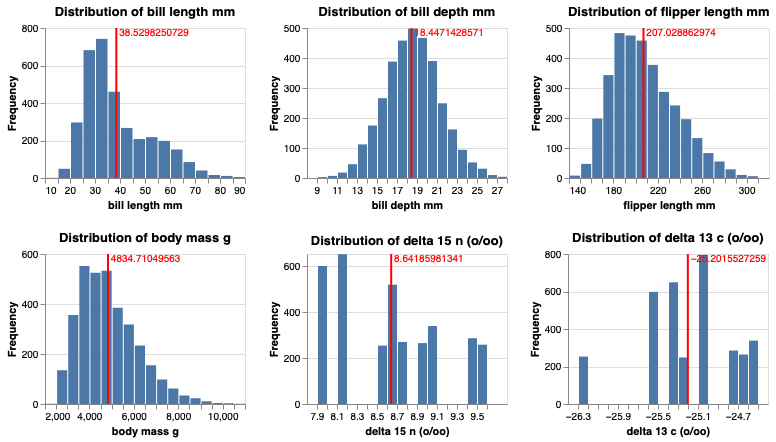

In [16]:
# display the numeric univariate charts
print("Numeric univariate visual summaries, with a red line indicating the attribute's mean value")

# formatting the charts together
numeric_charts_row_1 = numeric_univariate_charts[:len(numeric_univariate_charts)//2]
numeric_charts_row_2 = numeric_univariate_charts[len(numeric_univariate_charts)//2:]
row1 = alt.hconcat(*numeric_charts_row_1)
row2 = alt.hconcat(*numeric_charts_row_2)
numeric_charts = alt.vconcat(row1, row2)

numeric_charts

In [17]:
print("Categorical Summaries")
for col in penguins_final.select_dtypes(exclude=['int', 'float']).columns:
    print(penguins_final[col].value_counts()) # to print count of every category
    print('\n')

Categorical Summaries
species
Adelie       1560
Gentoo       1247
Chinstrap     623
Name: count, dtype: int64


island
Biscoe       1785
Dream        1133
Torgersen     512
Name: count, dtype: int64


sex
female    1726
male      1704
Name: count, dtype: int64


diet
krill       1419
fish         958
parental     860
squid        193
Name: count, dtype: int64


life stage
juvenile    1541
adult       1029
chick        860
Name: count, dtype: int64


health metrics
healthy        1550
overweight     1167
underweight     713
Name: count, dtype: int64


year
2024-01-01    877
2025-01-01    844
2023-01-01    695
2022-01-01    658
2021-01-01    356
Name: count, dtype: int64




In [18]:
# make bar charts for each categorical and temporal attribute
categorical_univariate_charts = []
for column in penguins_final.select_dtypes(exclude=['int', 'float']):
    
    chart = alt.Chart(penguins_final).mark_bar().encode(       #encode the bar charts
        alt.X('count()', title='Counts'),
        alt.Y(column +':N', title=column).sort('-x'),
    ).properties(
        width=200, height=150, title='Distribution of ' + column
    )
    
    text = chart.mark_text(
        align='left',
        baseline='middle',
        dx=5,  # Adjust this value to control the distance of the text from the bar
        color='black',
        size=8  # Adjust this value to control the font size
    ).encode(
        text='count()'
    )

    chart_with_text = (chart + text)
    categorical_univariate_charts.append(chart_with_text)

Categorial and temporal sorted univariate visual summaries


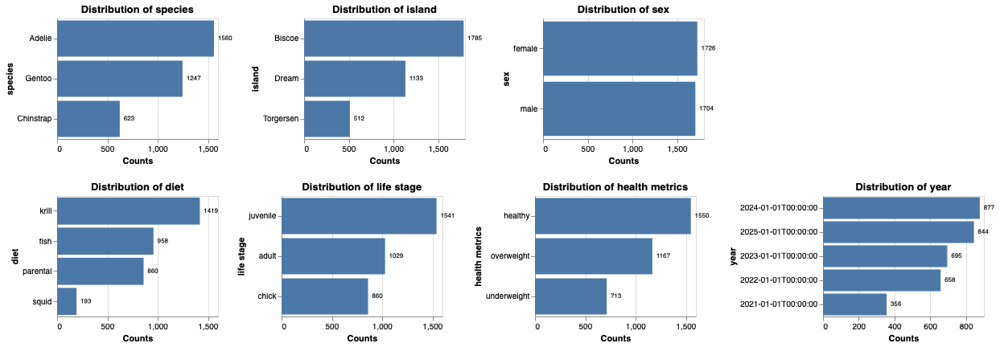

In [19]:
# display the categorial and temporal univariate charts
print("Categorial and temporal sorted univariate visual summaries")

# formatting the charts together
cat_charts_row_1 = categorical_univariate_charts[:len(categorical_univariate_charts)//2]
cat_charts_row_2 = categorical_univariate_charts[len(categorical_univariate_charts)//2:]
cat_row1 = alt.hconcat(*cat_charts_row_1)
cat_row2 = alt.hconcat(*cat_charts_row_2)
cat_charts = alt.vconcat(cat_row1, cat_row2)

cat_charts

#### Multivariate Summaries

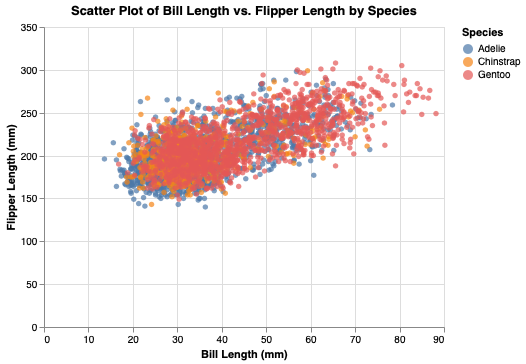

In [20]:
# a scatterplot
scatter_bill_flipper_species = alt.Chart(penguins_final).mark_circle().encode(
    alt.X('bill length mm:Q', title = 'Bill Length (mm)'),
    alt.Y('flipper length mm:Q', title = 'Flipper Length (mm)'),
    color=alt.Color('species', title='Species'),
    tooltip=['species', 'bill length mm', 'flipper length mm']
).properties(
    width=400,
    height=300,
    title='Scatter Plot of Bill Length vs. Flipper Length by Species'
)
scatter_bill_flipper_species

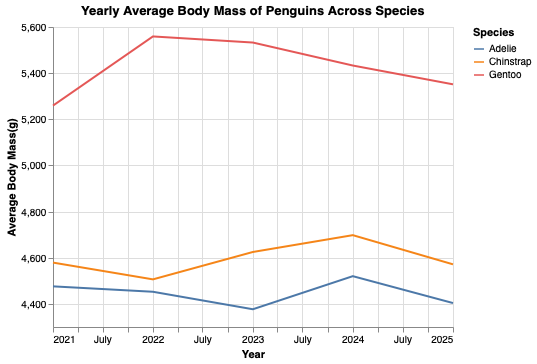

In [21]:
# a line chart
line_body_mass_over_time = alt.Chart(penguins_final).mark_line().encode(
    alt.X('year:T', title = 'Year'),
    alt.Y('average(body mass g):Q', title = 'Average Body Mass(g)').scale(zero=False),
    color=alt.Color('species', title='Species'),
    tooltip=['year', 'average(body mass g)']
).properties(
    width=400,
    height=300,
    title='Yearly Average Body Mass of Penguins Across Species'
)
line_body_mass_over_time

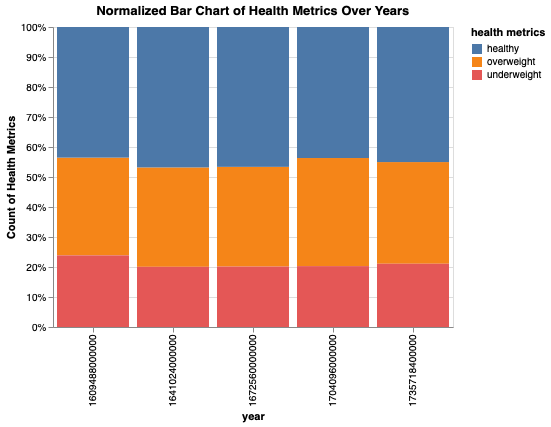

In [22]:
# a normalized bar plot
stacked_bar_health_metrics = alt.Chart(penguins_final).mark_bar().encode(
    alt.X('year:O'),
    alt.Y('count():Q', title = 'Count of Health Metrics').stack('normalize'),
    color='health metrics:N',
    tooltip=['year', 'health metrics', 'count()']
).properties(
    width=400,
    height=300,
    title='Normalized Bar Chart of Health Metrics Over Years'
)
stacked_bar_health_metrics

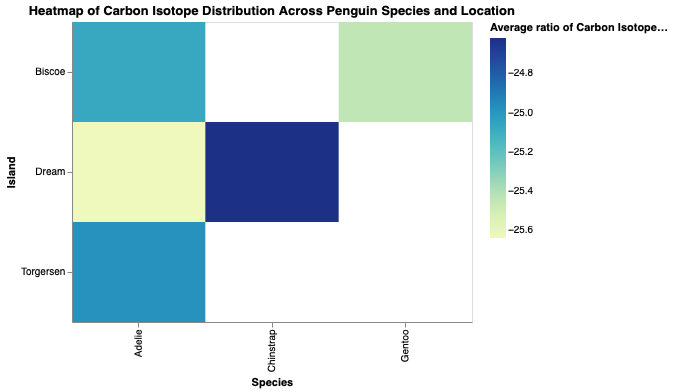

In [23]:
# a heatmap
heatmap_delta_13 = alt.Chart(penguins_final).mark_rect().encode(
    alt.X('species:N', title = 'Species'),
    alt.Y('island:N', title = 'Island'),
    alt.Color('average(delta 13 c (o/oo))', title = 'Average ratio of Carbon Isotope (o/oo)'),
    tooltip = ['species', 'island', 'average(delta 13 c (o/oo))']
).properties(
    width=400,
    height=300,
    title='Heatmap of Carbon Isotope Distribution Across Penguin Species and Location'
)
heatmap_delta_13

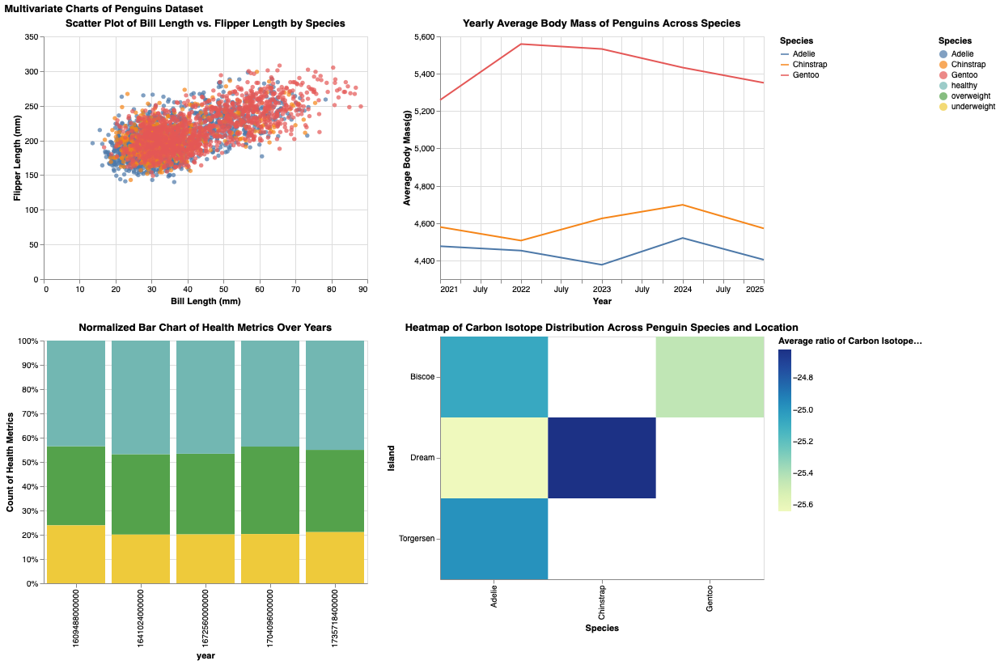

In [24]:
# combining the multivariate graphs made into a dashboard
multivariate_charts = (scatter_bill_flipper_species & stacked_bar_health_metrics) | (line_body_mass_over_time & heatmap_delta_13)
multivariate_charts.properties(title = 'Multivariate Charts of Penguins Dataset')

## Part II: Project Scope

### Introduction: Penguin Profiles: A Study of Species, Health, and Habitats in Palmer Archipelago


Exploration into the Ecological and Biological Dynamics of Penguins in the Palmer Archipelago Islands.

Through this project, we aim to explore the health, dietary patterns, and habitat distributions of penguins in the Palmer Archipelago Islands. By analyzing physical metrics, isotopic ratios, and other factors, we hope to gain insights into the ecological conditions, potential challenges, and distinctive traits of the three species inhabiting this domain.
<br><br>
Intended audience: Ecological Scientists, Ornithology Researchers, Environmental Conservationists, University Environmental Science Professors, Undergraduate and Postgraduate Ecology Students, Citizens involved with Antarctic wildlife conservation, etc 
<br><br>
The intended audience will be able to acquire a comprehensive understanding of the three penguin species' ecological conditions, health metrics, and dietary habits. They will be able to see how different diet impacts health metrics and the distribution of different penguins across the different islands in Palmer, providing information on habitat distribution. This project will provide scientists with a deeper understanding of the three species of penguins and their characteristics. This knowledge is pivotal for habitat conservation planning, guiding further ecological research, and enriching academic curricula. The motivation behind this project is to derive insights that can influence and inform conservation initiatives, ensuring the sustained presence of penguins in the Palmer Archipelago and promoting a deeper appreciation for the delicate balance of life in Antarctica. 

### Task Analysis

Task 1: Penguin Weight Change over Time:
-	Body Mass g 
-	Species
-	Sex
-	Island 
-	Year 

Task 2: Comparison of Gender-based Health Variation of Different Species:
-	Species
-   Sex
-	Health Metrics
-	Bill Length mm
-	Bill depth mm
-	Flipper length mm
-	Body Mass g 
-	Diet
-	Life Stage 

Task 3: Physical Characteristics of Penguins over Life Stages:
-	Species
-	Bill Length mm
-	Bill Depth mm
-	Flipper Length mm
-	Body Mass g 
-	Life Stage

Task 4: Penguin Diet and Health Status Trends
-	Diet
-	Life Stage
-	Health Metrics
-	Body Mass g 
-	Species

Task 5: Habitat Influence on Penguin Characteristics:
-	Island 
-	Species 
-	Diet
-	Health Metrics 
-	Bill Length mm  
-	Bill Depth mm 
-	Body Mass g
-	Delta 15 n (o/oo) 
-	Delta 13 c (o/oo) 

## Part III: Visualization Ideas

### Preliminary Sketches

**Task 1: Penguin Weight Change over Time**

***Sketch 1 of Task 1***

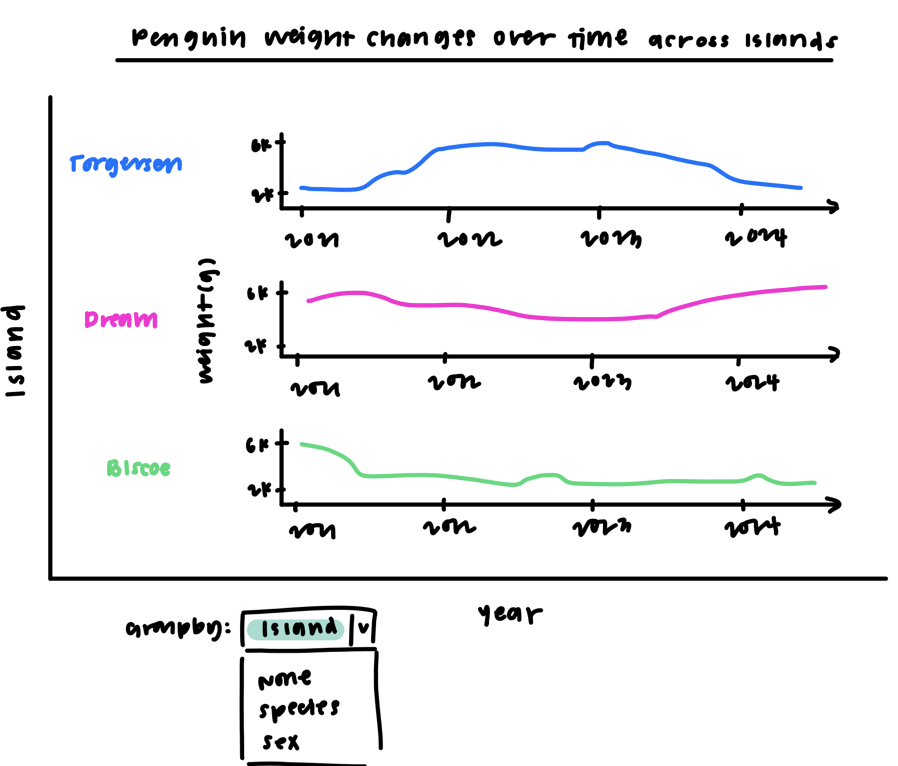

In [25]:
from IPython.display import display, Image
display(Image(filename="images/Task1-Sketch1.png", width=500))

***Sketch 2 of Task 1***

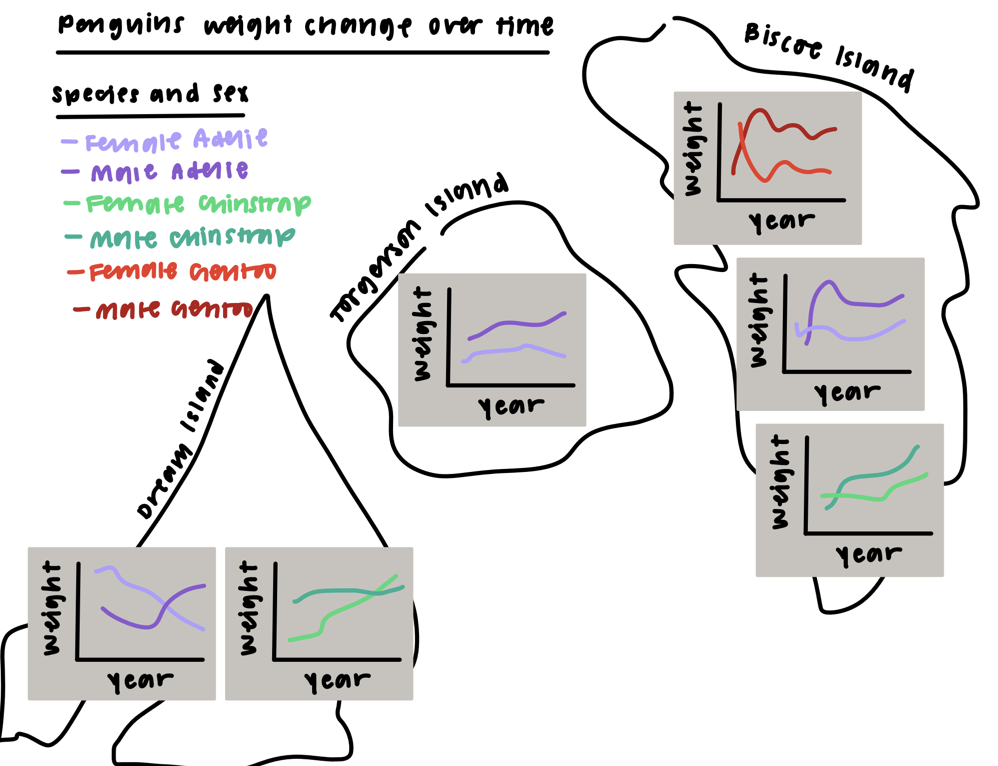

In [26]:
display(Image(filename="images/Task1-Sketch2.png", width=500))

***Sketch 3 of Task 1***

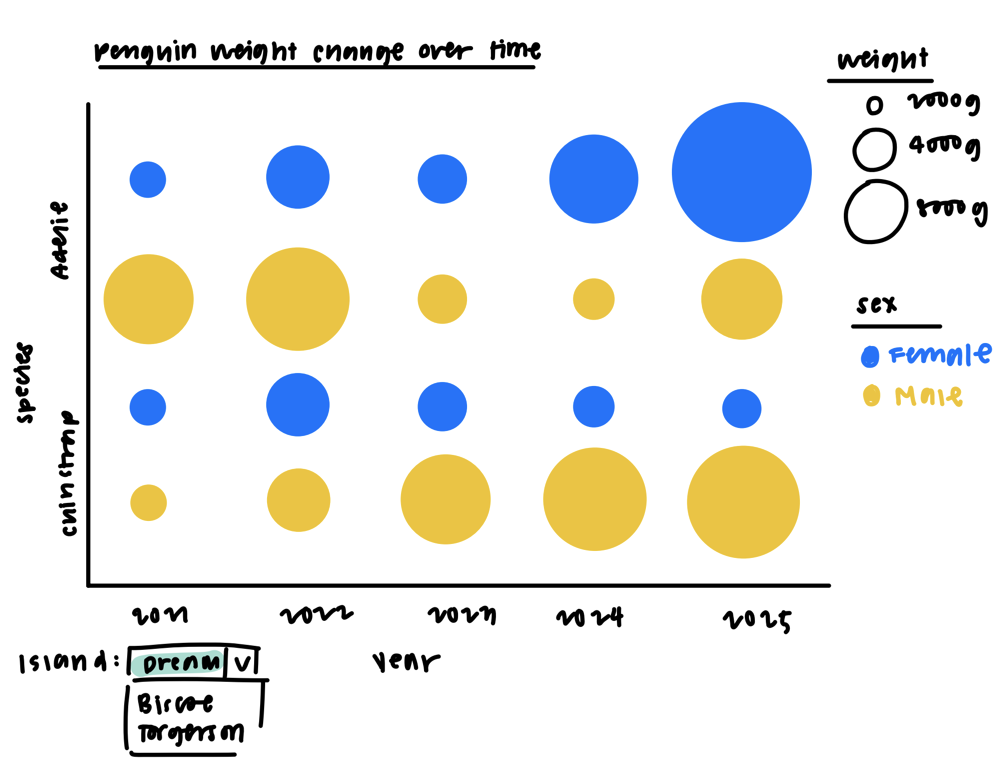

In [27]:
display(Image(filename="images/Task1-Sketch3.png", width=500))

Critiques for Task 1, Penguin Weight Change over Time, Sketches: 
- The faceted line chart is clear and effectively shows a penguins weight over time, however, the use of a facetted graph can make it difficult to directly compare a penguins weight from one facet group to another impacting its effectiveness.
- The faceted line charts layered amonst islands is aesthetic, however, it is ineffective for comparison as the individual graphs are spread across the map.
- The circle marked heatmap is effective with displaying the distribution of weight over time across multiple penguin groups, sex and species in the example, however, it is difficult to gauge and discern the differences between the areas of the circles.

***Final Sketch of Task 1***

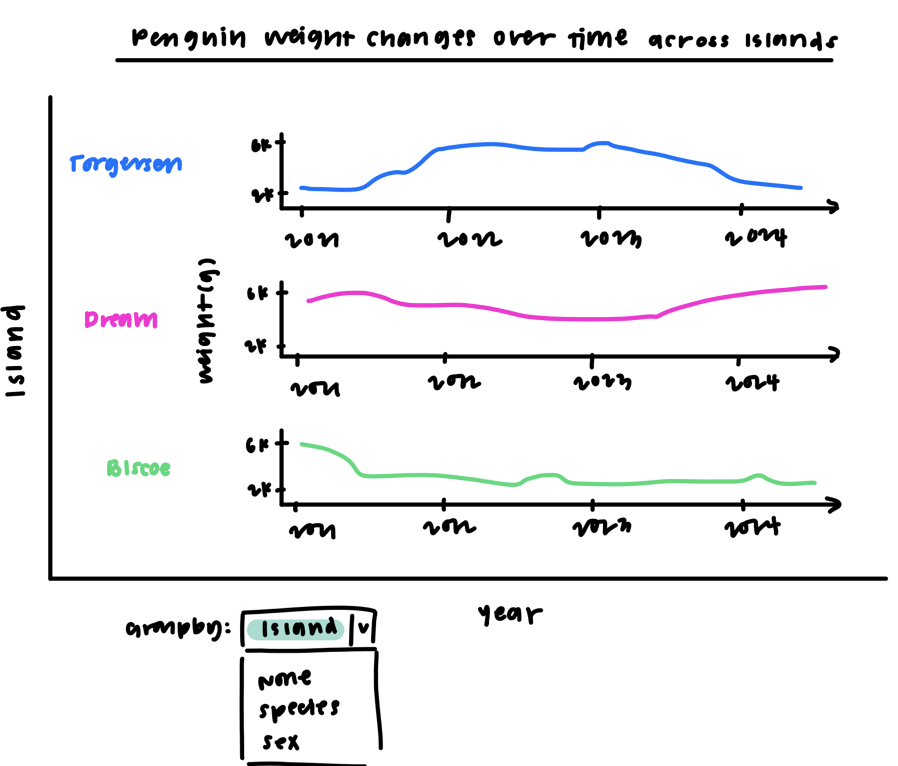

In [28]:
display(Image(filename="images/Task1-Sketch1.png", width=500))

The final selected visualization is the faceted line chart. The colour hue channel represents the different nominal values that the graph could be grouped on, where the categorical attribute of either island, species, or sex can be interactively chosen by the dropdown menu. It is noted that there are no more than 3 unique values for the selectable categorical attribute, making it easier to differentiate and discern the differences between them. The quantitative weight attribute and temporal year attribute are plotted together with the position and length channels for a line chart, these choices are clear in showing the change in a penguins weight over time and a penguins weight at a certain time. Each facetted chart is easily comparable to the other as each chart has common scales. Overall, the chart aligns with the expressiveness principle while being effective for the task of a penguins weight change over time.

**Task 2: Gender-based Health Variation Analysis**

***Sketch 1 of Task 2***

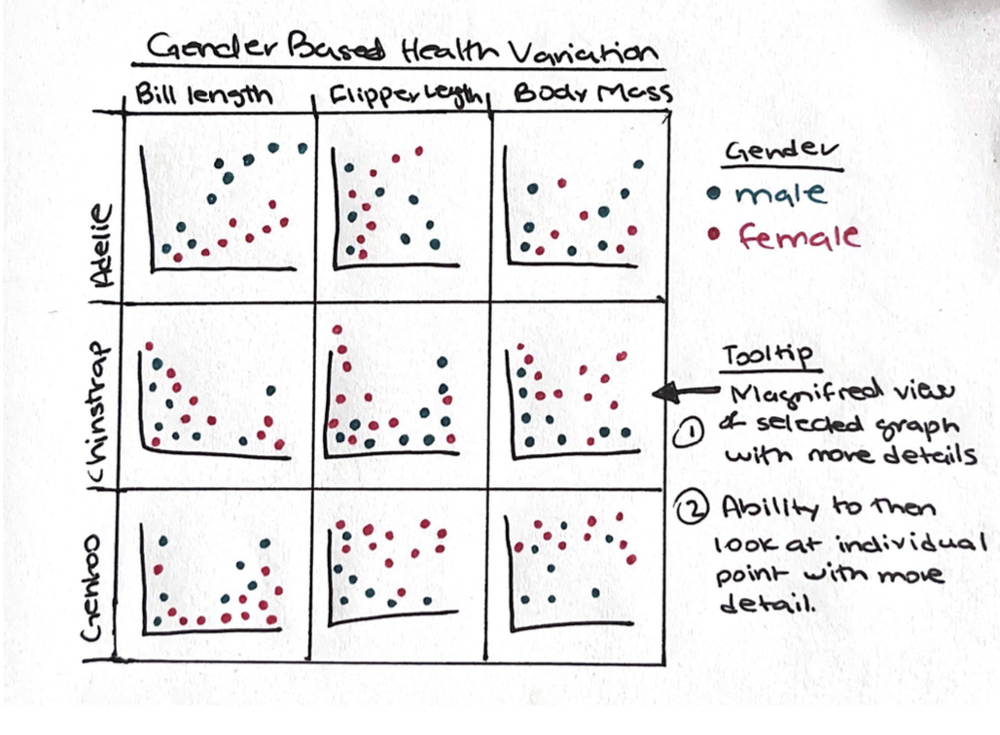

In [29]:
display(Image(filename="images/Task2-1 .png", width=500))

***Sketch 2 of Task 2***

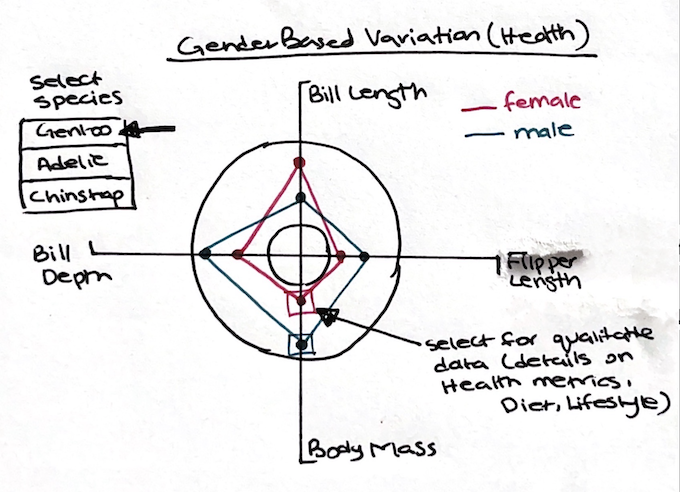

In [30]:
display(Image(filename="images/Task2-2 .png", width=500))

***Sketch 3 of Task 2***

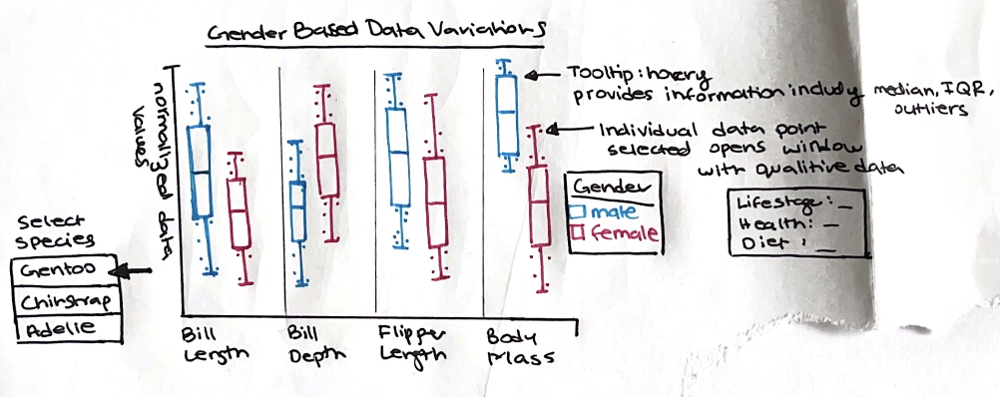

In [31]:
display(Image(filename="images/Task2-3 .png", width=500))

Critiques for Task 2, Gender-based Health Variation Analysis, Sketches: 

- The Scatter Plot Dashboard enables visualization of specific data, revealing patterns and correlations by gender within species. A con however is that it can be cluttered with excess data, necessitating clear design and consistent scales for comparison.
- The Spider Chart Plot offers a straightforward design highlighting quantitative differences between genders, facilitating quick visual comparisons of health variations. It is poor at including qualitative data; data can become unclear due to overlap. Presents only average values thus is is missing detailed analysis.
- The Box plots are able to concisely summarize data, showcasing central tendency, variability, and outliers for straightforward group comparisons. Less intuitive for qualitative data, and may overlook detailed patterns since it is not displaying all of data points (just the outliers)

***Final Sketch of Task 2***

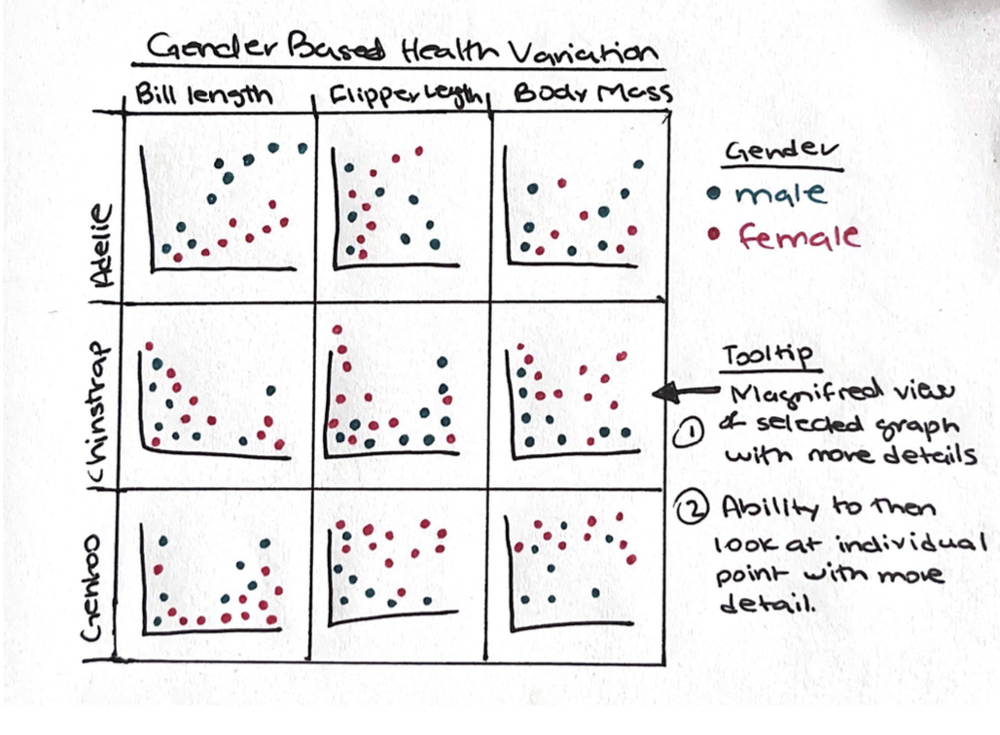

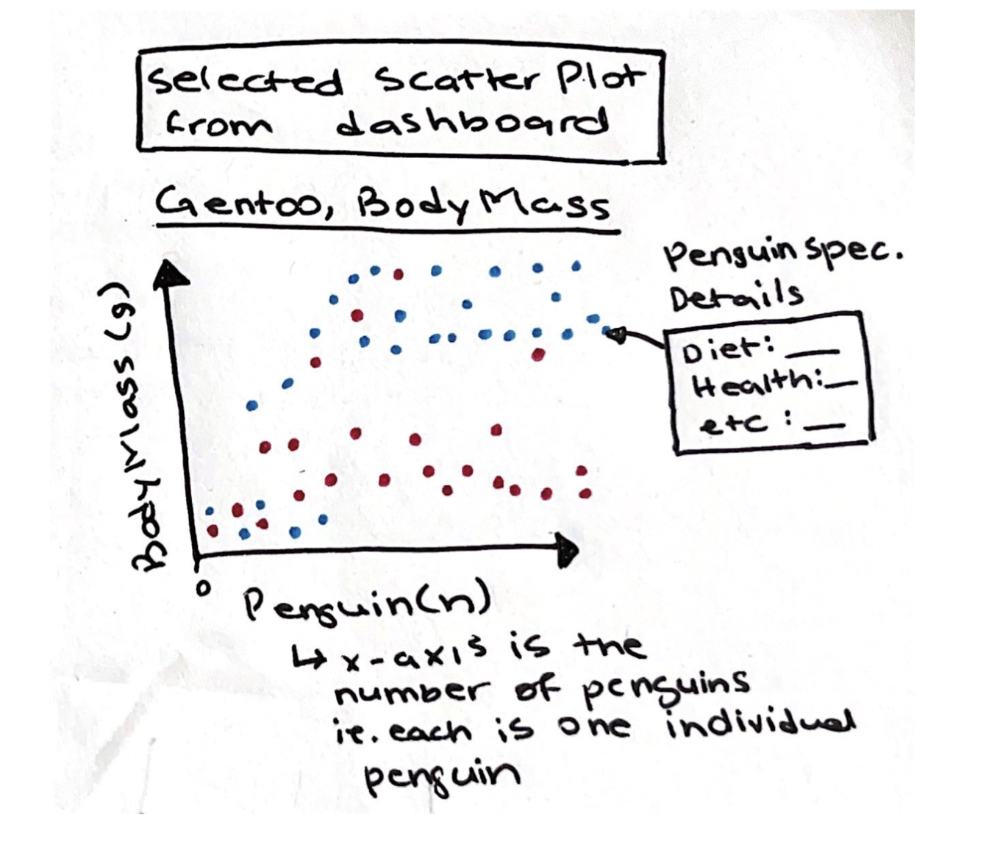

In [32]:
display(Image(filename="images/Task2-1 .png", width=600))
display(Image(filename="images/Task2-1(detail).png", width=300))

The Scatter Plot Dashboard is the best option as it provides a comprehensive, comparative, and clear depiction of the dataset. It shows individual data points, can identify patterns and outliers, and can visualize relationships between variables.
The graph allows for comparative analysis which is important as we want to make direct comparisons across the difference species and genders. The graph also facilitates multivariate analysis as it can display multiple variables simultaneously (*able to show health metrics, diet, etc, all split by species and gender*). The specific graph for the desired data can be selected by the user for a more in-depth analysis. 

**Task 3: Physical Characteristics of Different Life Stages**

***Sketch 1 of Task 3***

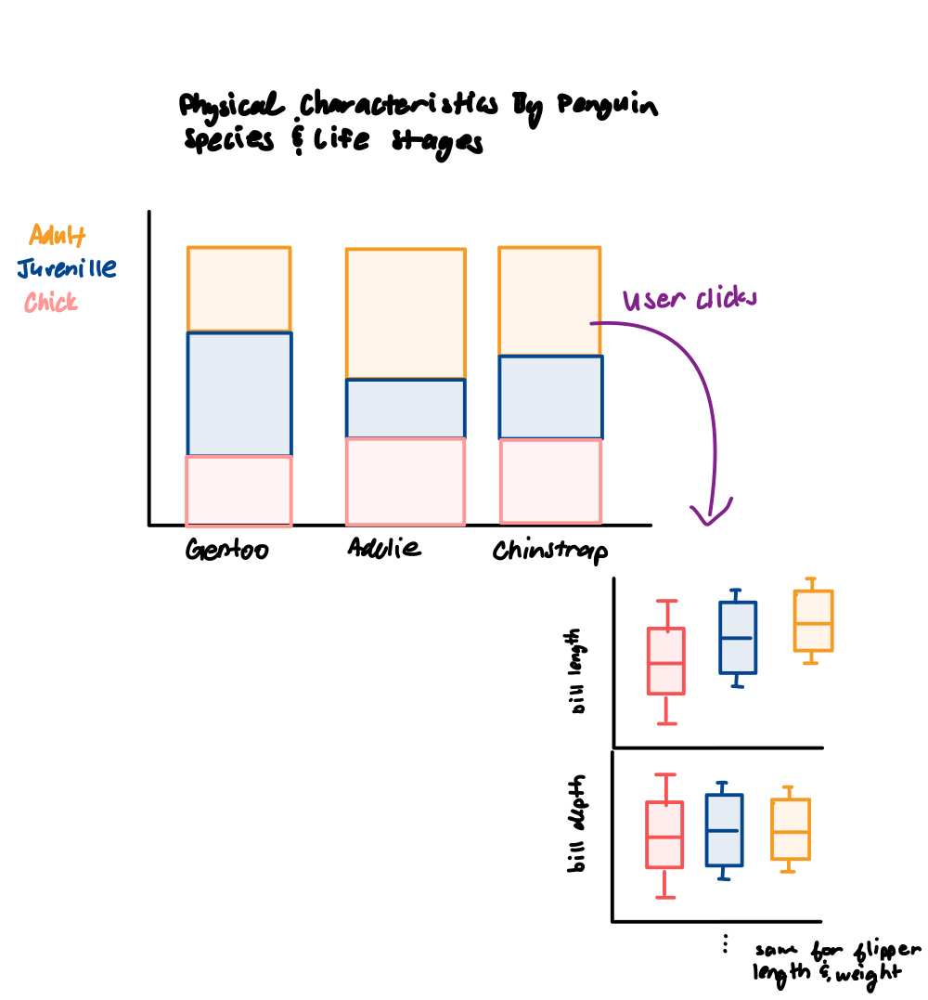

In [33]:
display(Image(filename="images/task3_bar.jpeg", width=500))

***Sketch 2 of Task 3***

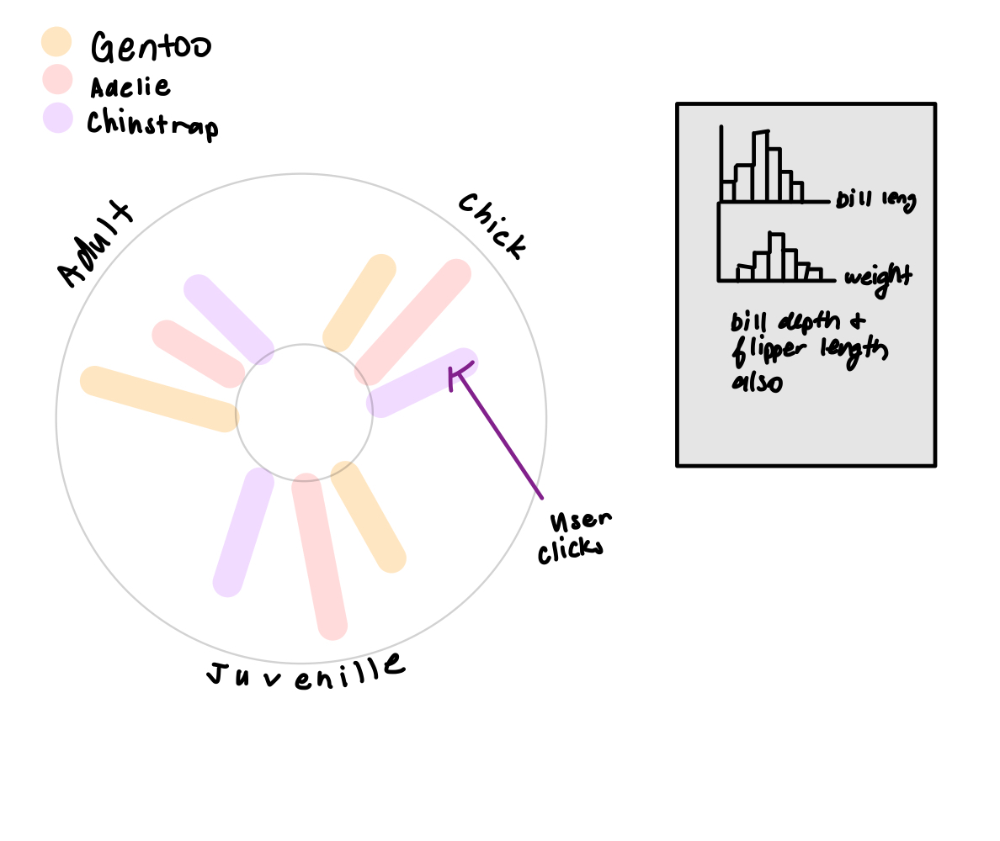

In [34]:
display(Image(filename="images/task3_radial.jpeg", width=500))

***Sketch 3 of Task 3***

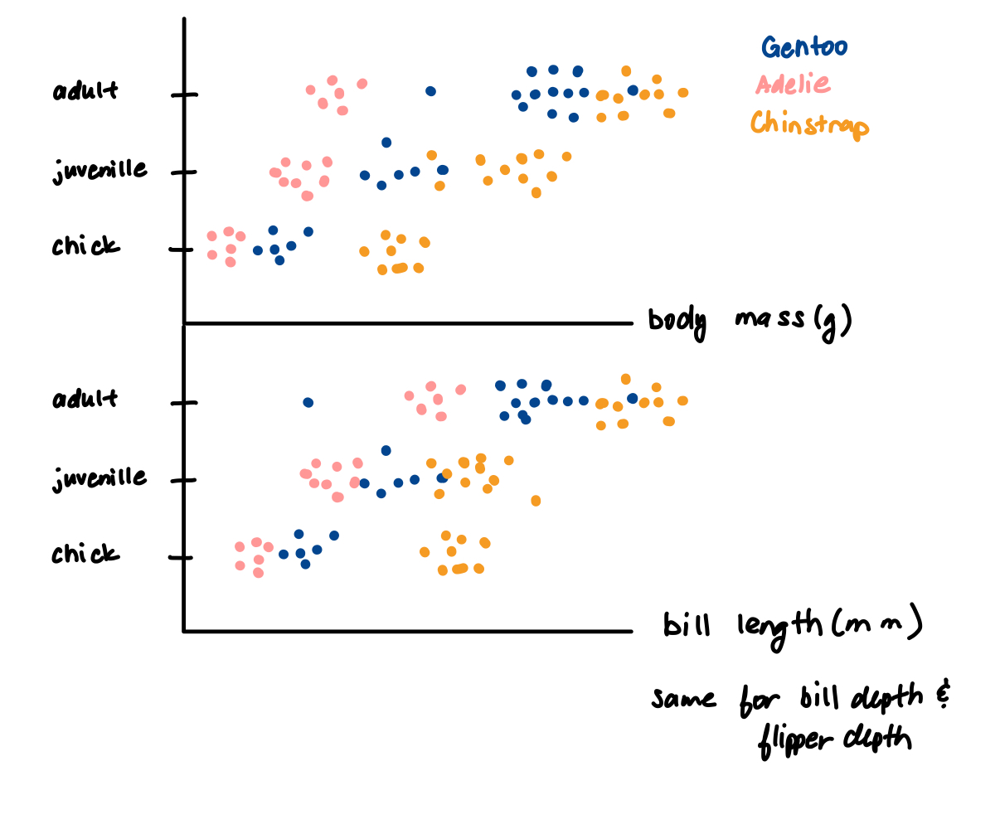

In [35]:
display(Image(filename="images/task3_scatter.jpeg", width=500))

Critques for Task 3, Physical Characteristics of Different Life Stages, Sketches: 
-	The normalized bar chart effectively shows the proportion of penguins at each life stage for each species. The boxplot is effective at showing the quantitative metric distribution at different life stages for the selected species. 
-	The radial histogram aesthetic but is not effective at displaying the distribution count at each life stage, but without a scale, it is difficult to determine the precise count. Similarly, because the bars are at different angles, on an unaligned scale, it is more difficult to determine if one bar is shorter or taller than another bar. 
-	The faceted scatterplot is easy to compare the distributions across different species and life stages for all the quantitative data types. However, using circle as the marks, there is over 3 000 data points, so it will be crowded and difficult to see any patterns.


***Final Sketch of Task 3***

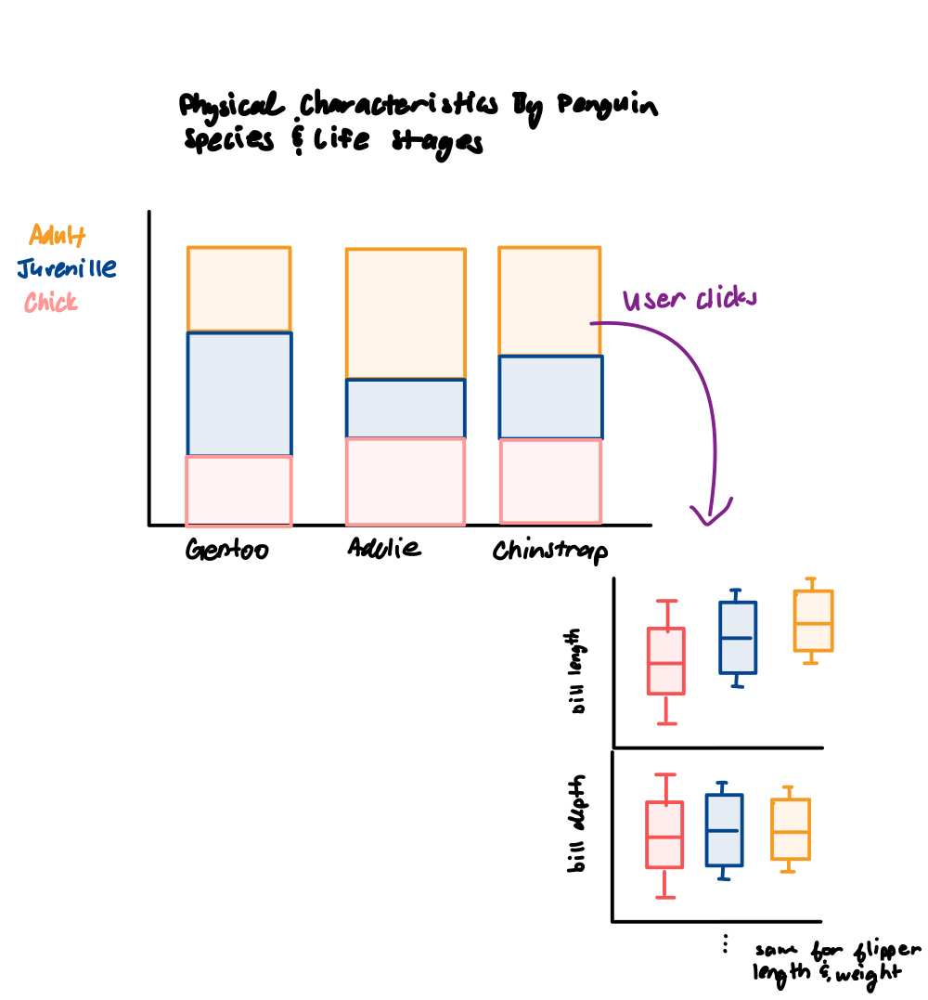

In [36]:
display(Image(filename="images/task3_bar.jpeg", width=500))

The final selected vis is the normalized bar chart. Channels selected adhere to the expressiveness principle. Colour hue and spatial region are used to represent categorical data types of species, and life stage. Quantitative data types such as bill length, weight, etc. are represented using position on scale, implying an order. It adheres to effectiveness principles, the bars are grouped by species, so it is easy to see them as their own separate entity, and only three colours are used, so it is easy to differentiate.  Overall, it able to show what life stages penguins are at for a particular species and is effectiveness at making comparisons between the physical traits at different life stages. 

**Task 4: Penguin Diet and Health Status Trends**

***Sketch 1 of Task 4***

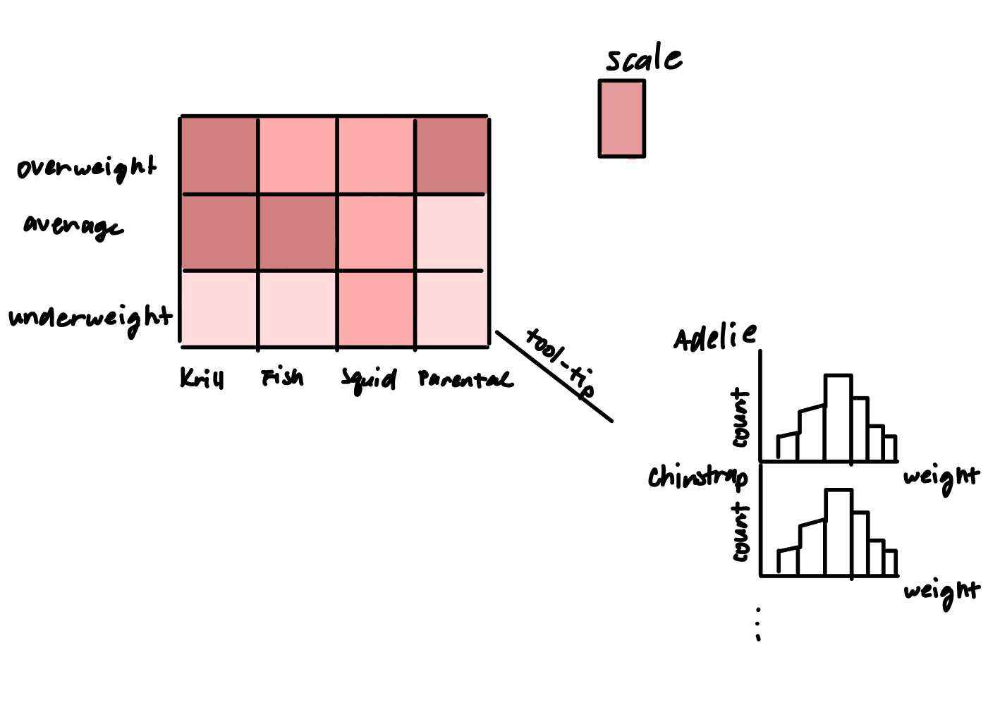

In [37]:
display(Image(filename="images/task4_heatmap.jpeg", width=500))

***Sketch 2 of Task 4***

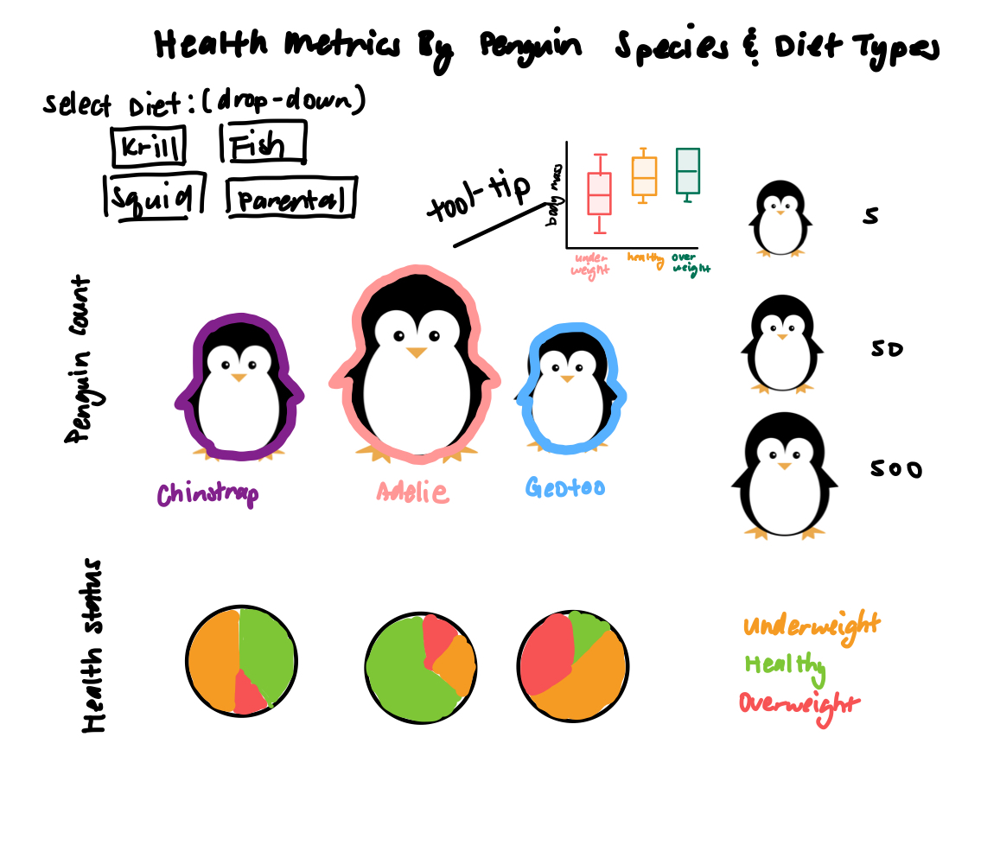

In [38]:
display(Image(filename="images/task4_penguins.jpeg", width=500))

***Sketch 3 of Task 4***

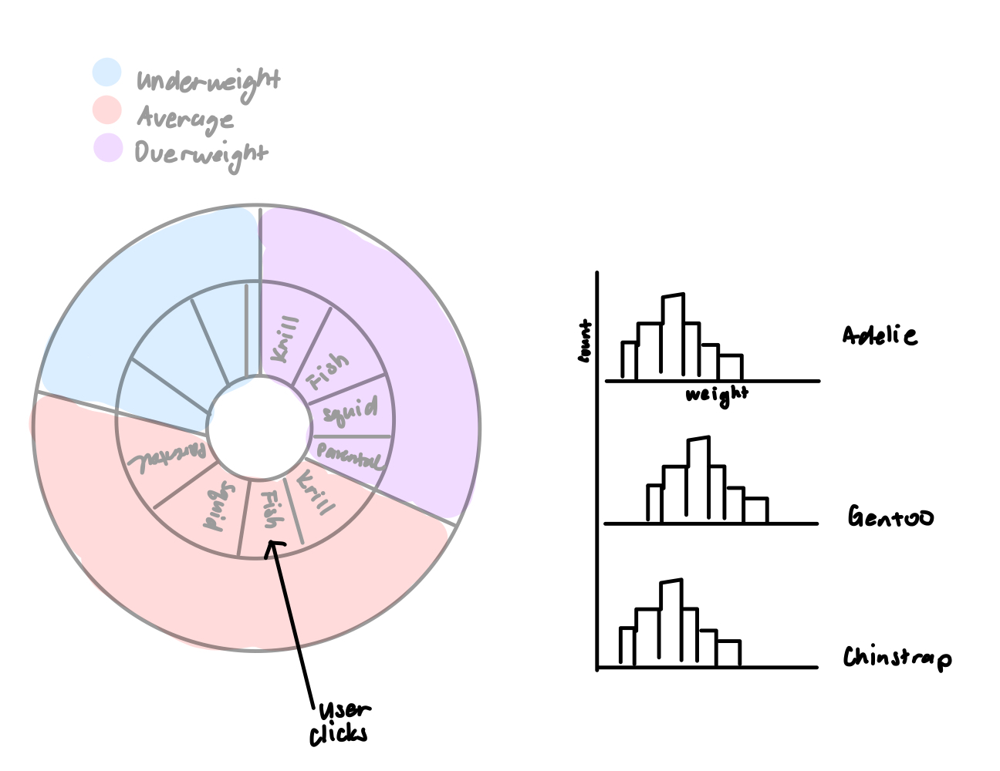

In [39]:
display(Image(filename="images/task4_suburst.jpeg", width=500))

Critques for Task 4, Penguin Diet and Health Status Trends, Sketches:

-	The heatmap is effective at showing how diet types and health categories are related, however, colour saturation represents the count, which can be difficult to differentiate to the human eye. It also doesn't show how diet patterns between different species, one of the objectives of the task. 
-	The penguin graph is effective at showing how what diet types each species are consuming, as colour is used to separate the grouping of penguins, making it easy to see the different species. It is difficult to precisely determine the difference between the penguin sizes because there is no common scale.
-	In the sunburst graph, labels are used to differentiate between the diet types, and since it is coloured using the colours from species, it is difficult to separate violating the effectiveness principle. It is effective at showing the proportion of penguins in each health category, but for more granular analysis, it is not. 

***Final Sketch of Task 4:***

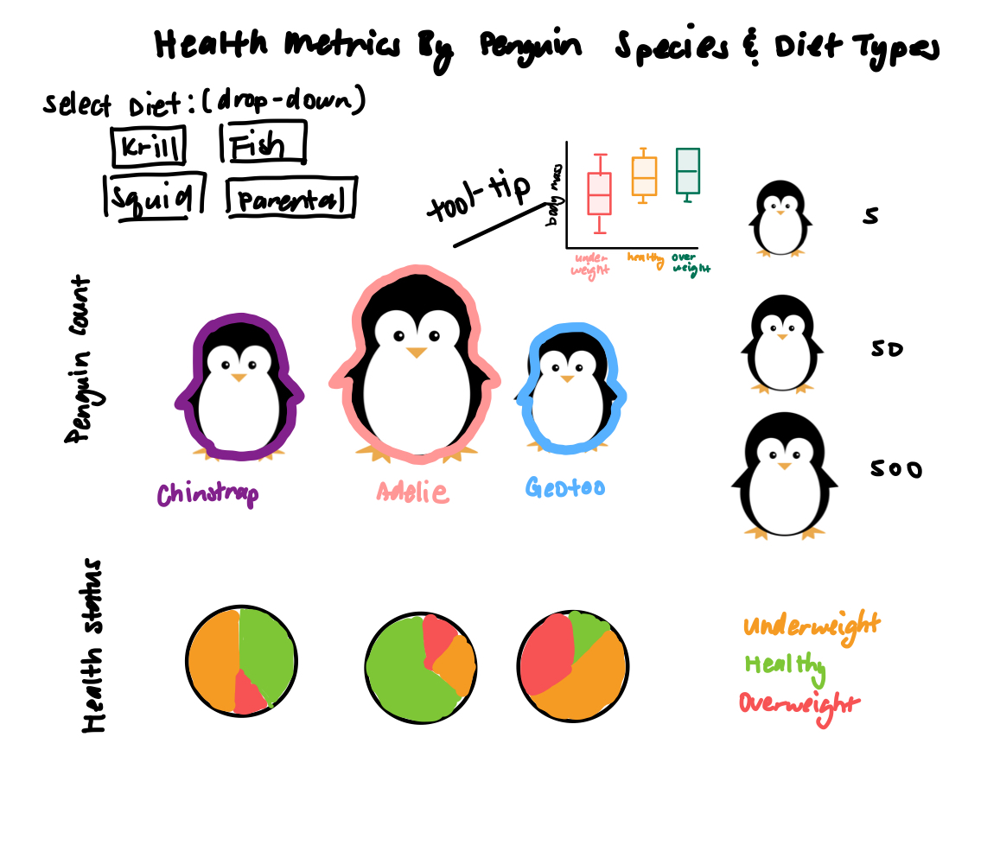

In [40]:
display(Image(filename="images/task4_penguins.jpeg", width=500))

The selected vis is the penguin chart. Colour hue is used to represent species and doesn’t imply order, following the expressiveness principle. Since there are only three colours, it’s easy to make comparisons between the species. The area of the penguin is used to represent the proportion of species consuming that diet, which an appropriate channel for a quantitative channel. The pie chart for each species, effectively addresses the task and displays the health category for penguins of a particular species and diet consumed. Having the user interact and select the diet and see how the penguin size and pie charts change increases engagement. Overall, it addresses the task and can show how different diet types impact the health of penguins, and what diets different species consume. 

**Task 5: Habitat Influence on Penguin Characteristics**

***Sketch 1 of Task 5***

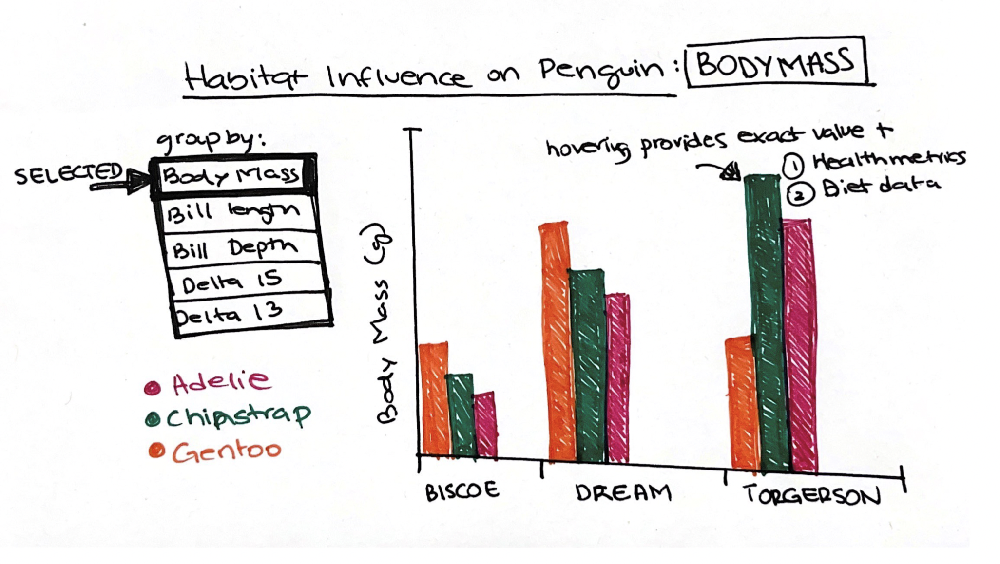

In [41]:
display(Image(filename="images/Task5-1.png", width=600))

***Sketch 2 of Task 5***

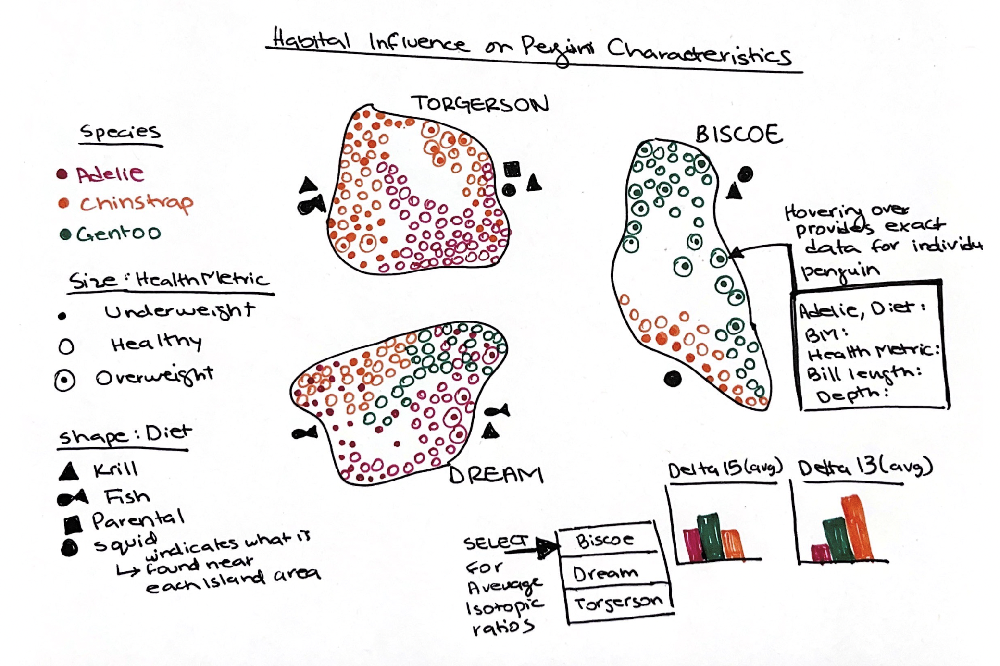

In [42]:
display(Image(filename="images/Task5-2.png", width=600))

***Sketch 3 of Task 5***

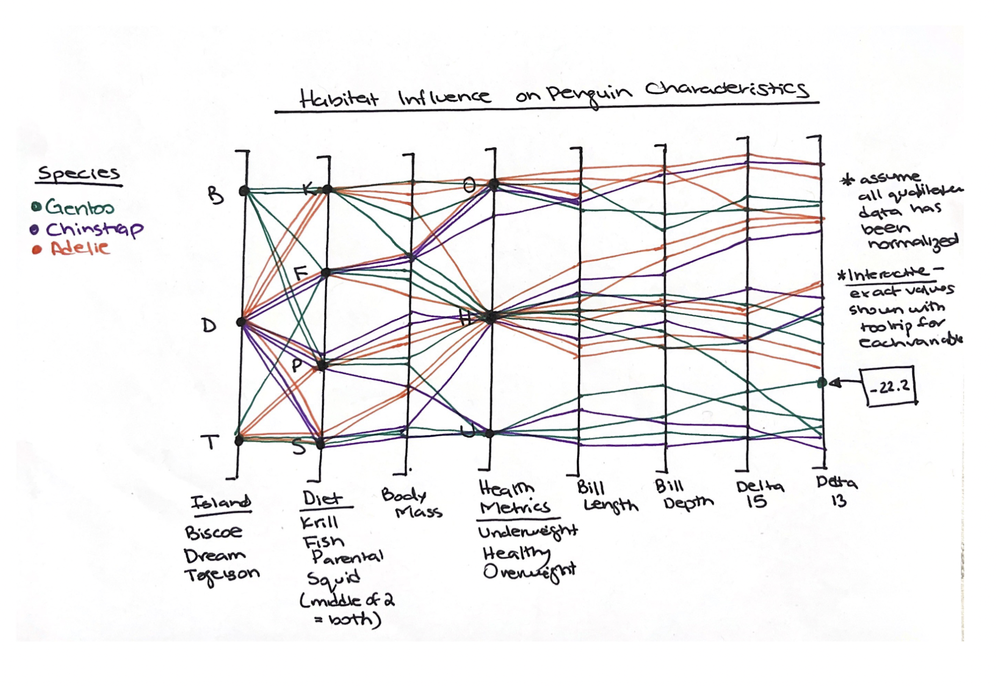

In [43]:
display(Image(filename="images/Task5-3.png", width=600))

Critiques for Task 5, Habitat Influence on Penguin Characteristics, Sketches: 
- The bar chart displays clear, direct comparisons between species for specific attributes without overwhelming users, enhancing focus and engagement through interactivity. Does not allow for cross-variable comparison, risking overlooked patterns and correlations, and relies heavily on the interactive interface for effective data communication.
- The Map Plot provides intuitive geographical context with visual differentiation of penguin species, linking location with traits like diet and health, using color and symbols for multiple attributes. However, differentiating for health metrics can be unclear, isotopic ratios aren't directly shown. Too much information is overwhelming but too little can be misleading.
- The Parallel coordinates plot allows for comparison of multiple attributes, revealing correlations, clusters, and anomalies across species. It can be too complex for some people, with overlapping lines and large datasets causing clutter. Precise values are unclear, and axis ordering and scale sensitivity could lead to misinterpretation. 

***Final Sketch of Task 5:***

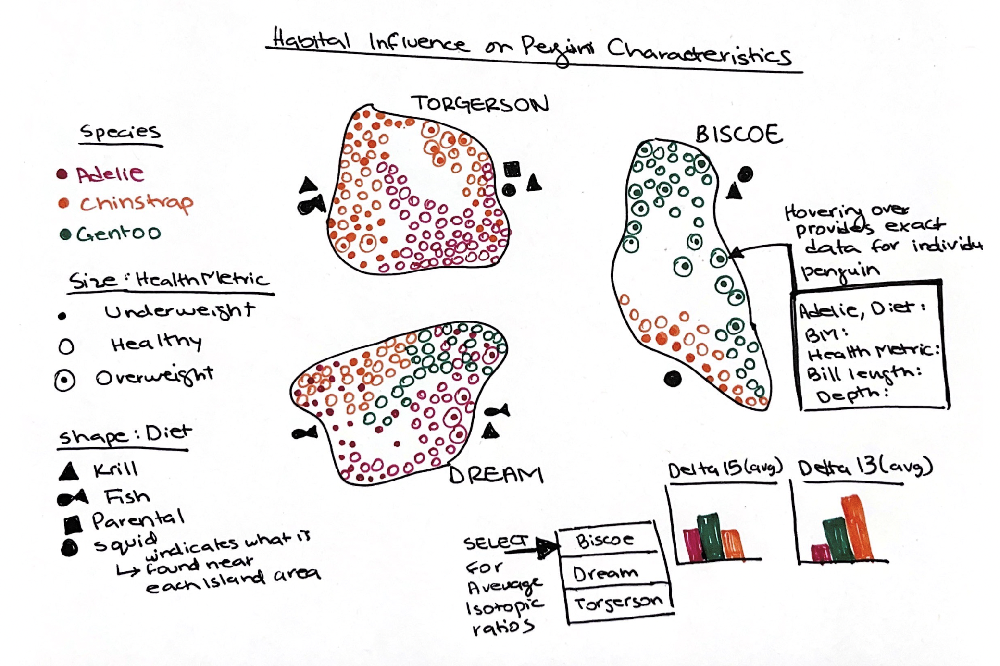

In [44]:
display(Image(filename="images/Task5-2.png", width=600))

Among the three, the Parallel Coordinates Plot is the best choice for visualizing the Habitat Influence on Penguin Characteristics as it allows for the examination of multiple attributes simultaneously, which allows us to detect any patterns or correlations. This plot allows for the visualization of all chosen attributes simultaneously (*island, species, diet, health metrics, bill size, body mass, and isotopic ratios*), allowing for a complete analysis. This plot can identify correlations between attributes more clearly than the other options. It also allows us to spot any outliers. Creating an interactive parallel coordinates plots can help mitigate the cons such as cluttering or misinterpretation. Interactive filtering can help avoid overplotting. Addiontally, the order of the axes can be chosen specicially to highlight the most important relationships, and interactivity could also allow users to experiment with different orderings.

## Part IV: Next Steps

### Outline of Next Steps for Assignment 2: 

**1) Divide Responsibilities:**

*Michelle: Focus on encoding and designing the visuals.* 

*Kelly: Handle interaction implementation.*

*Mariam: Oversee presentation and layout.* 

**2) Brainstorm Novel Visualization:**

All collaborate and think together to come up with ideas for the novel hand-drawn aesthetic visualization. One person takes the lead to draft the high-fidelity sketch.

**3) Interaction and Testing:** 

5 visualizations encoded, ensuring there are least 2 interactive views.


Next steps (example): 

*Michelle: Implements interactive features for visualizations. Begins initial testing.* 

*Kelly: Refines the UI widget interaction.* 

*Mariam: Ensures visualization works: Test the user experience of the interactions, provide feedback for refinement.*

**4) Layout and Consistency Check:** 

Collaboratively review all visualizations for consistent encoding and interaction patterns. Adjust layouts so that screen space is used effectively, add all necessary text elements.

**5) Finalize Report and Review:**
 
Steps: 

*Mariam: Prepares initial draft of the report, summarizing tasks, provide screenshots of visualizations.* 

*Michelle: Adds to the report with a focus on explaining the interaction techniques and justify choices.* 

*Kelly: Completes the report with a section on the novel visualization, including the high-fidelity sketch and a critique of the visualization views.*

All: Review and edit the final report to ensure all grading rubric items are addressed. Proofread before submission.


***Teamwork Strategy:***

**Ongoing Communication:** Maintain an open line of communication to update each other on progress, challenges, etc.

**Peer Review:** Review one another's work to provide feedback and maintain quality and consistency.

**Shared Responsibilities:** Ensure each person has a clear area of responsibility with some overlap for shared understanding and support. Layout design and novel visualization creation are collaborative tasks where all members contribute equally. Report writing is a divided task but comes together as a group effort for one final report.

**Final Review:** Collaboratively review the entire dashboard and report, ensuring it meets all project requirements.
 